In [1]:
import pandas as pd
import numpy as np
import warnings
from pandas_profiling import ProfileReport
import sys

#visualization
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from sktime.utils.plotting import plot_series, plot_lags, plot_correlations
#from visuals import *


#config to clean up the notebook
pd.set_option('display.max_columns', None)
pd.options.display.float_format = '{:.2f}'.format
warnings.filterwarnings('ignore')


In [2]:
#read the training data and parse the dates into a datetime object
df = pd.read_csv(
        'train.csv',
        usecols=['store_nbr', 'family', 'date', 'sales', 'onpromotion'],
        dtype={
            'store_nbr' : 'category',
            'family' : 'category',
            'sales' : 'float32',
        },
        parse_dates=['date'],
        infer_datetime_format=True,
)

#convert the date into a period 
#df['date'] = df.date.dt.to_period('D')

#set a multiindex and sort to clean up the display of dataframe
df = df.set_index(['store_nbr', 'family', 'date']).sort_index()
df.head()

sales  onpromotion
store_nbr family     date                          
1         AUTOMOTIVE 2013-01-01   0.00            0
                     2013-01-02   2.00            0
                     2013-01-03   3.00            0
                     2013-01-04   3.00            0
                     2013-01-05   5.00            0

In [3]:
#aggregate the stores daily sales by product family
df_family = (
    df.groupby(['family', 'date']).mean().unstack('family')
)
display(df_family.head())
df_family.shape

sales                                                \
family     AUTOMOTIVE BABY CARE BEAUTY BEVERAGES BOOKS BREAD/BAKERY   
date                                                                  
2013-01-01       0.00      0.00   0.04     15.00  0.00         3.34   
2013-01-02       4.72      0.00   3.83   1335.04  0.00       486.04   
2013-01-03       2.98      0.00   2.31    964.91  0.00       341.79   
2013-01-04       3.13      0.00   2.46   1003.09  0.00       309.67   
2013-01-05       6.33      0.00   3.54   1441.07  0.00       414.22   

                                                                             \
family     CELEBRATION CLEANING  DAIRY   DELI   EGGS FROZEN FOODS GROCERY I   
date                                                                          
2013-01-01        0.00     3.44   2.65   1.32   0.85         0.55     12.96   
2013-01-02        0.00  1382.02 432.98 291.75 202.44       131.77   3741.11   
2013-01-03        0.00  1035.06 333.35 206.90 136.26        88.16   2682.93   
2013-01-04        0.00   964.15 336.07 187.84 125.19        83.81   2513.96   
2013-01-05        0.00  1298.67 427.44 254.35 158.81       107.07   3488.07   

                                                                       \
family     GROCERY II HARDWARE HOME AND KITCHEN I HOME AND KITCHEN II   
date                                                                    
2013-01-01       0.28     0.00               0.00                0.00   
2013-01-02      27.33     0.85               0.00                0.00   
2013-01-03      19.41     0.69               0.00                0.00   
2013-01-04      19.09     1.06               0.00                0.00   
2013-01-05      23.57     1.61               0.00                0.00   

                                                                          \
family     HOME APPLIANCES HOME CARE LADIESWEAR LAWN AND GARDEN LINGERIE   
date                                                                       
2013-01-01            0.00      0.00       0.00            0.04     0.09   
2013-01-02            0.39      0.00       0.00            2.24     8.69   
2013-01-03            0.28      0.00       0.00            1.54     6.78   
2013-01-04            0.24      0.00       0.00            2.35     7.07   
2013-01-05            0.20      0.00       0.00            3.33     8.48   

                                                                         \
family     LIQUOR,WINE,BEER MAGAZINES  MEATS PERSONAL CARE PET SUPPLIES   
date                                                                      
2013-01-01             1.94      0.00   2.05          0.46         0.00   
2013-01-02            44.65      0.00 386.51        318.59         0.00   
2013-01-03            45.85      0.00 307.36        232.74         0.00   
2013-01-04            88.81      0.00 400.48        209.31         0.00   
2013-01-05           124.35      0.00 386.65        311.46         0.00   

                                                                   \
family     PLAYERS AND ELECTRONICS POULTRY PREPARED FOODS PRODUCE   
date                                                                
2013-01-01                    0.00    0.79           0.70    0.00   
2013-01-02                    0.00  258.81          98.85    0.00   
2013-01-03                    0.00  197.67          66.51    0.00   
2013-01-04                    0.00  199.49          82.83    0.00   
2013-01-05                    0.00  249.54         107.96    0.00   

                                              onpromotion                   \
family     SCHOOL AND OFFICE SUPPLIES SEAFOOD  AUTOMOTIVE BABY CARE BEAUTY   
date                                                                         
2013-01-01                       0.00    0.00        0.00      0.00   0.00   
2013-01-02                       0.00   28.27        0.00      0.00   0.00   
2013-01-03                       0.00   20.27        0.00      0.00   0.00  

(1684, 66)

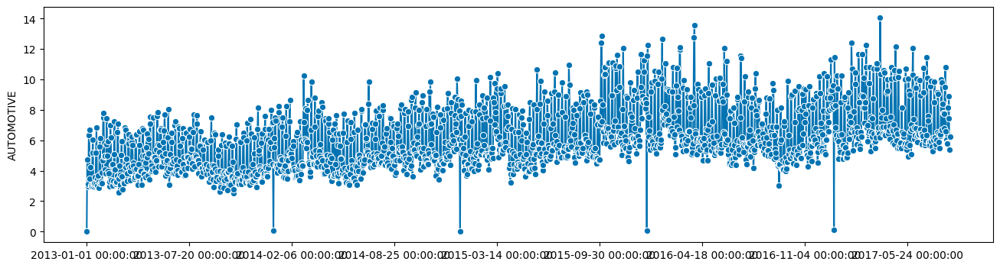

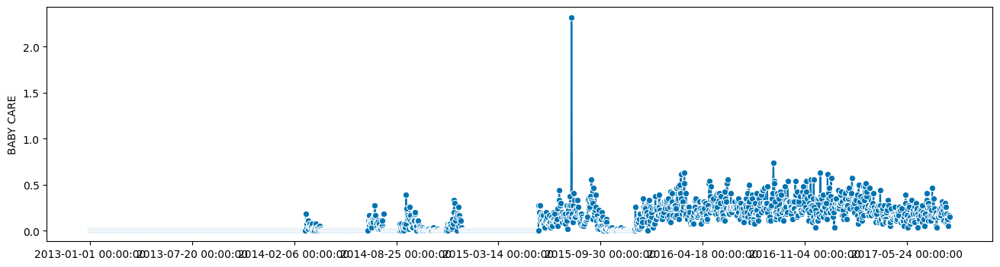

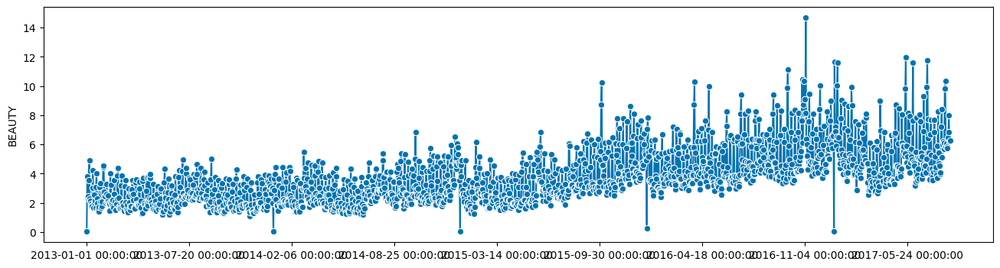

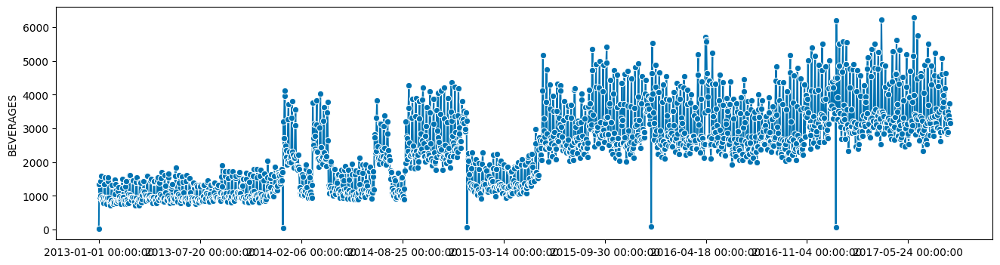

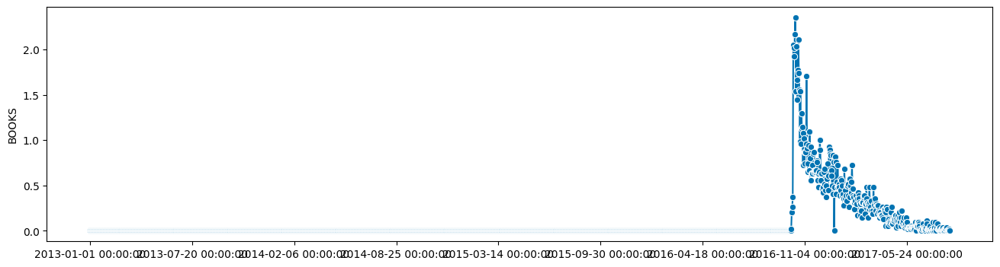

...

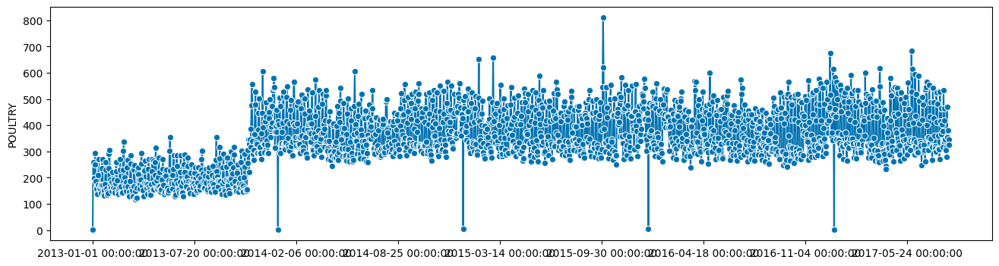

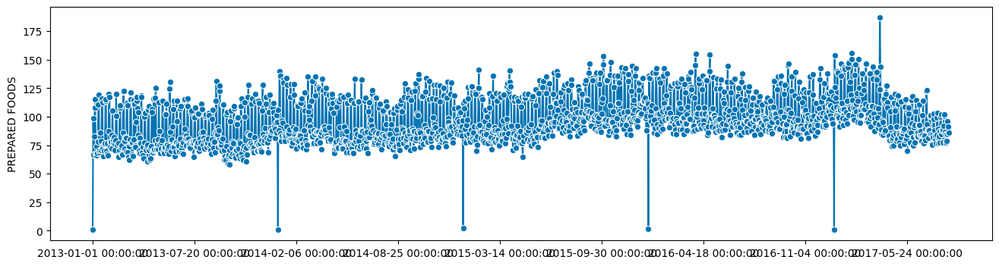

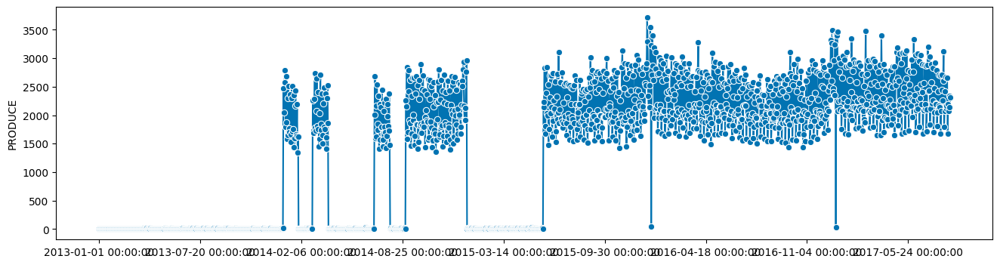

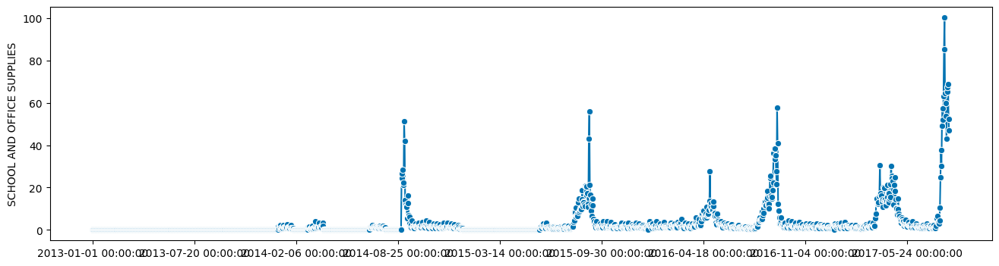

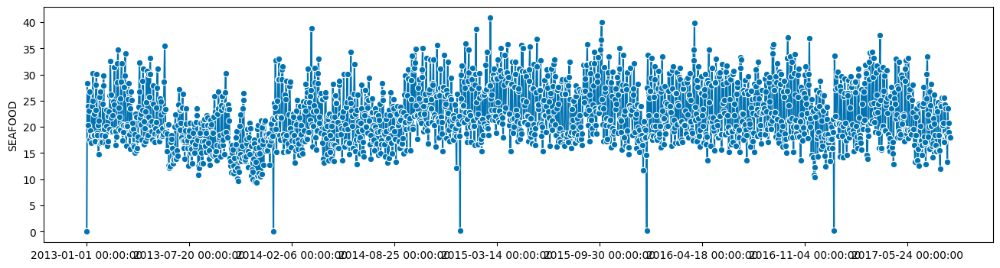

In [4]:
#lets plot out each family sales time series to take an initial look at the data
for col in df_family.sales.columns:
    plot_series(df_family.sales[col])

### Initial look at the target variable's time plots
We can see a few interesting things right away:
1) There is one day in every year that has 0 sales for all product families, this likely is a holiday where all stores are closed. It looks like it could be Christmas.
2) There are some product families that were likely not sold in stores until a certain date within the data
3) there are some product families with very large consecutive periods of zero sales that will be difficult to explain without specific domain knowledge
4) there are some very obvious single point outliers of extreme magnitude which are possibly the result of errors in the data, we can investigate this further.

In [5]:
#lets check what christmas day looks like in each year
temp = df_family.sales.sum(axis=1)
display(temp.loc[np.logical_and(temp.index.day == 25, temp.index.month == 12)])

#lets check to see if there are any other missing dates
pd.date_range(start = '2013-01-01', end='2017-08-15').difference(temp.index)

Series([], dtype: float32)

DatetimeIndex(['2013-12-25', '2014-12-25', '2015-12-25', '2016-12-25'], dtype='datetime64[ns]', freq=None)

In [6]:
#lets see where the big gap in produce happens as an example for issue 2
df_family.sales[df_family.sales['CELEBRATION'] == 0.00].CELEBRATION.loc['2015']

2015-01-01   0.00
2015-01-02   0.00
2015-01-03   0.00
2015-01-04   0.00
2015-01-05   0.00
             ... 
2015-05-27   0.00
2015-05-28   0.00
2015-05-29   0.00
2015-05-30   0.00
2015-05-31   0.00
Name: CELEBRATION, Length: 151, dtype: float32

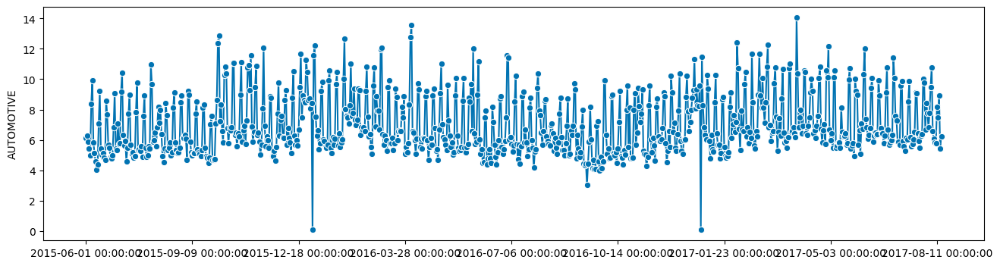

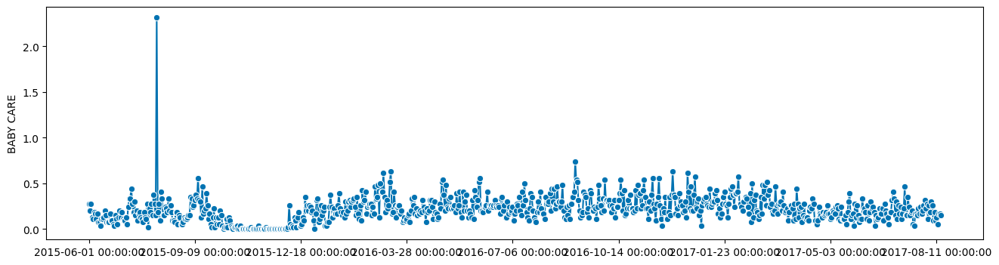

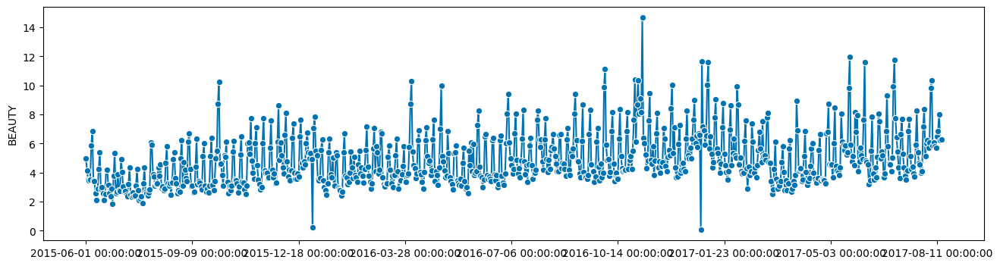

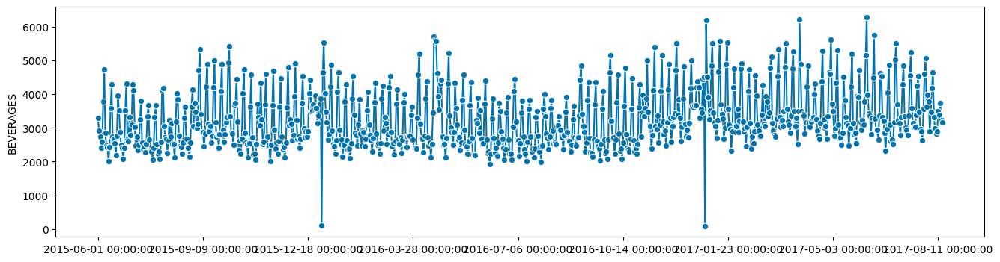

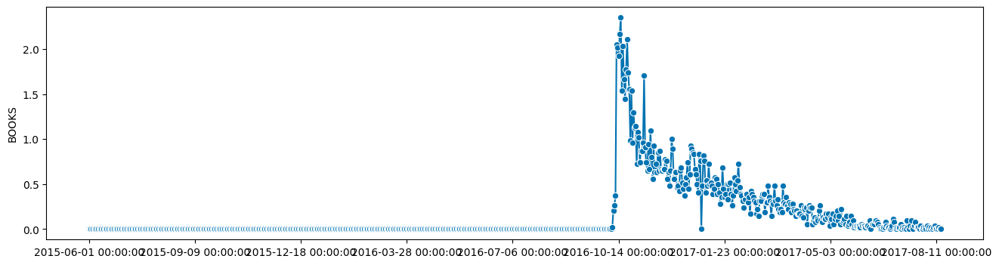

...

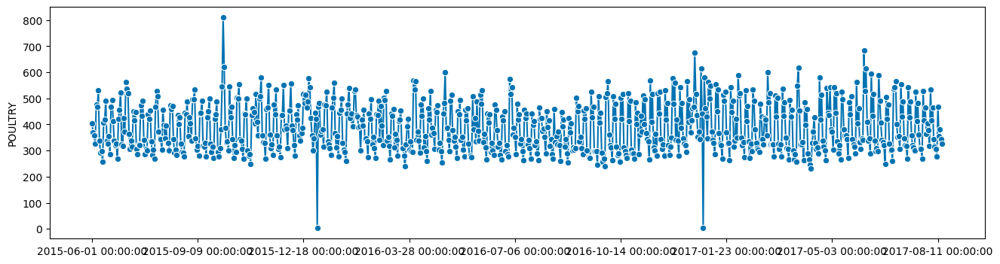

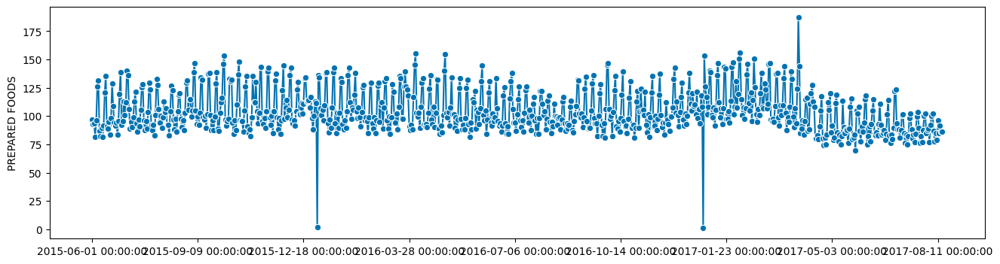

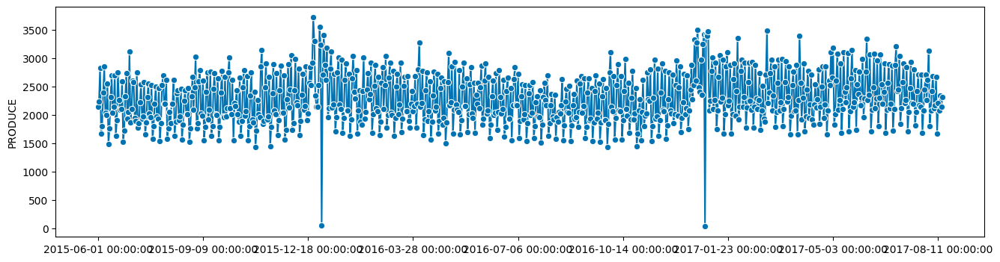

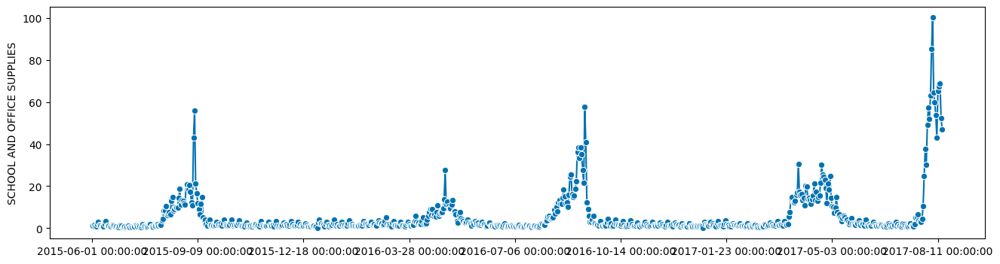

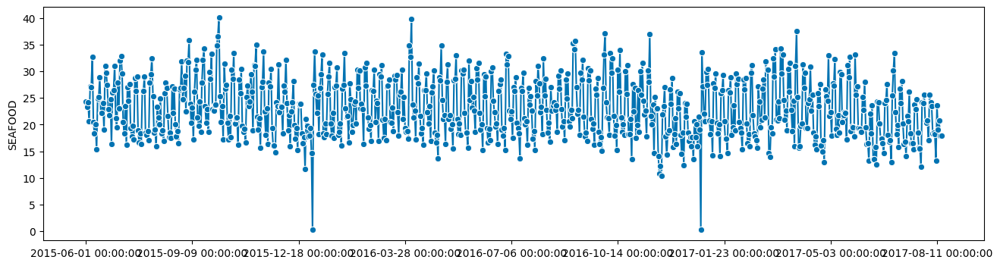

In [7]:
# lets try plotting the series again starting on 2015-06-01
date_filter = df_family.sales.loc['2015-06-01' : '2017-08-15']
for col in date_filter.columns:
    plot_series(date_filter[col])

##### That looks much cleaner already! We will lose some data but our models will not do well with so many 0 values, and 2 years of data is enough to properly capture most seasonalities!

Next lets deal with the missing christmas dates. In prediction, we can just utilize a conditional zero-prediction strategy to replace the predictions our models might make, since we know that the stores will be closed on this day. To help our models out, however, lets impute a 5 record average centered around the christmas dates. This will give our models a time series with no gaps, while causing minimal disruption to the signal.

In [8]:
#lets filter the entire dataframe by the previous date range
df_filtered = df_family.loc['2015-06-01' : '2017-08-15']

#lets add blank records for christmas days
idx = pd.to_datetime(['2015-12-25', '2016-12-25'], format='%Y/%m/%d')
new_row = pd.DataFrame(columns = df_filtered.columns, index=idx)
new_row.fillna(value=0.00, axis=1, inplace=True)

#lets add them into the filtered dataframe and sort the index
df_filtered = pd.concat([df_filtered, pd.DataFrame(new_row)], ignore_index=False).sort_index()

#now lets impute the values for each column as a centered average of its 4 neighbors
for i in idx:
    for col in df_filtered.sales.columns:
        df_filtered.sales.loc[i][col] = (
            df_filtered.sales.loc[i- pd.Timedelta(2, unit='days'), col] +
            df_filtered.sales.loc[i- pd.Timedelta(1, unit='days'), col] +
            df_filtered.sales.loc[i+ pd.Timedelta(1, unit='days'), col] +
            df_filtered.sales.loc[i+ pd.Timedelta(2, unit='days'), col]
        ) / 4.00
        df_filtered.onpromotion.loc[i][col] = (
            df_filtered.onpromotion.loc[i- pd.Timedelta(2, unit='days'), col] +
            df_filtered.onpromotion.loc[i- pd.Timedelta(1, unit='days'), col] +
            df_filtered.onpromotion.loc[i+ pd.Timedelta(1, unit='days'), col] +
            df_filtered.onpromotion.loc[i+ pd.Timedelta(2, unit='days'), col]
        ) / 4.00
#now lets plot those time plots again




##### From looking at a tabular version of the dataframe, its apparent there is also a similar issue with New Years Day. Although the date is present, and some stores seem to be open, the sales amounts are basically 0 relative to the values around those times. I think we should employ the same zero prediction and imputation strategy here.



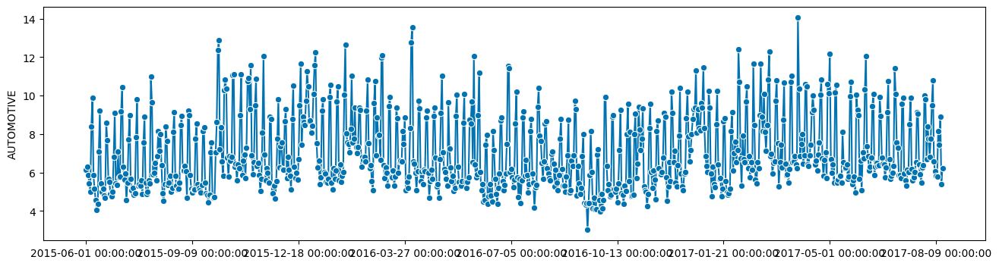

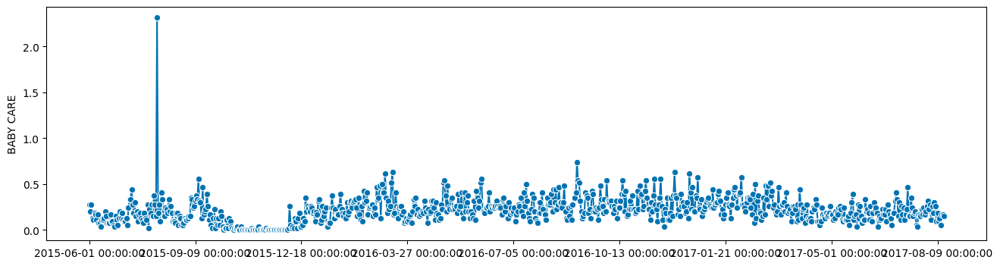

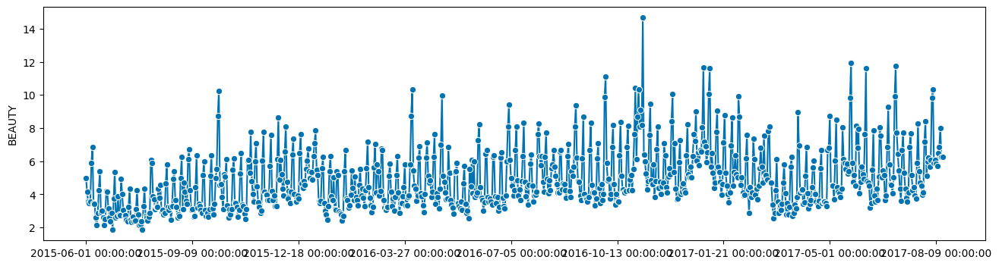

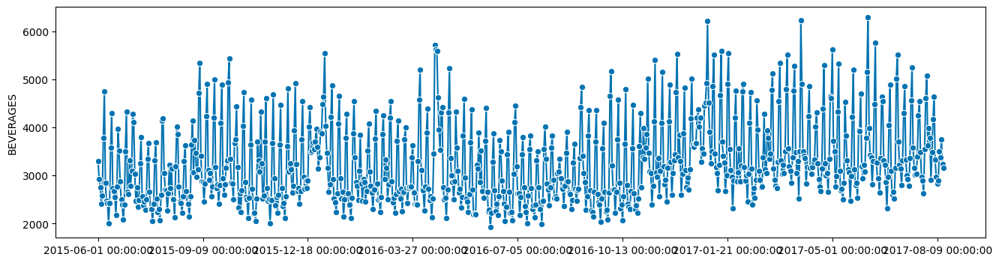

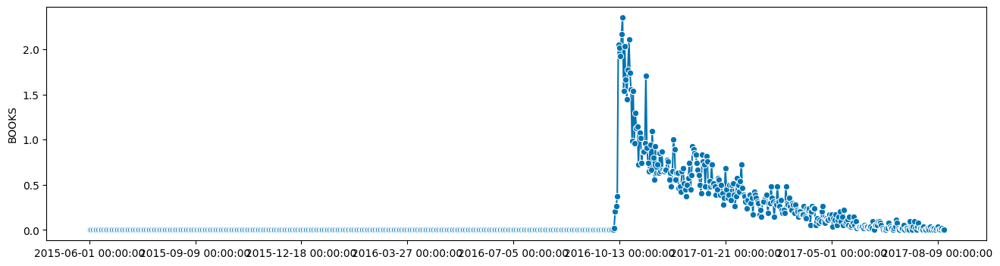

...

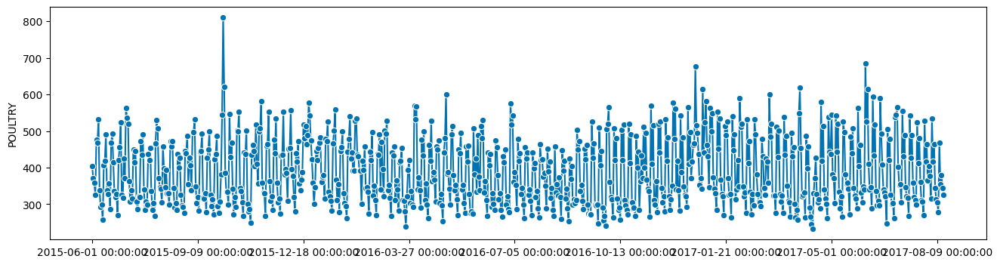

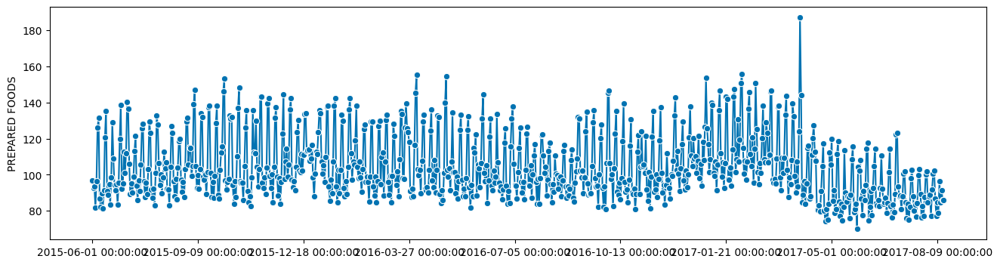

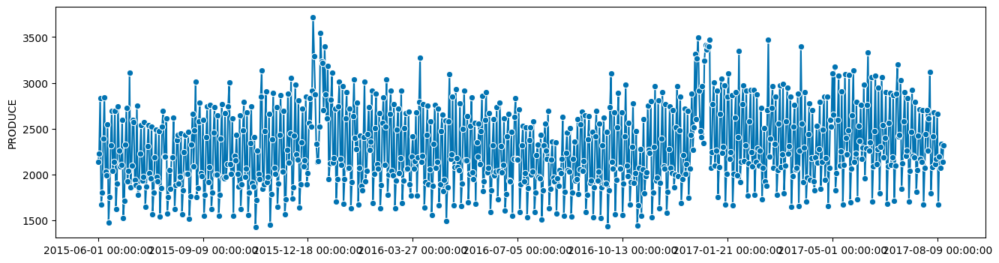

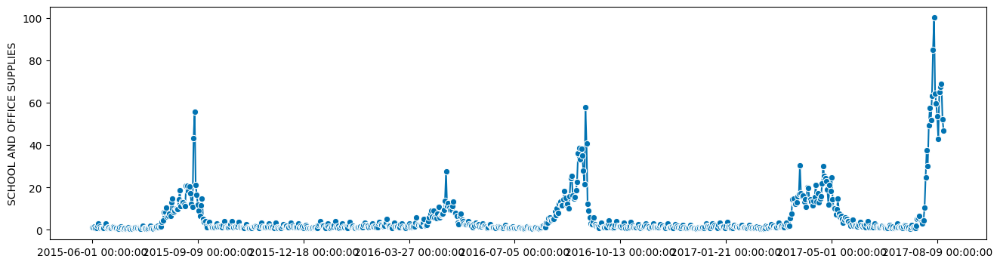

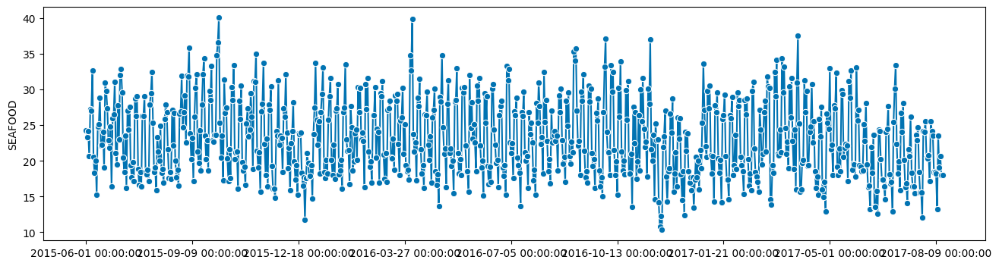

In [11]:
#lets make the indexes for new years day
idx = pd.to_datetime(['2016-01-01', '2017-01-01'], format='%Y/%m/%d')

#now lets impute the values for each column as a centered average of its 4 neighbors
for i in idx:
    for col in df_filtered.sales.columns:
        df_filtered.sales.loc[i][col] = (
            df_filtered.sales.loc[i- pd.Timedelta(2, unit='days'), col] +
            df_filtered.sales.loc[i- pd.Timedelta(1, unit='days'), col] +
            df_filtered.sales.loc[i+ pd.Timedelta(1, unit='days'), col] +
            df_filtered.sales.loc[i+ pd.Timedelta(2, unit='days'), col]
        ) / 4.00
        df_filtered.onpromotion.loc[i][col] = (
            df_filtered.onpromotion.loc[i- pd.Timedelta(2, unit='days'), col] +
            df_filtered.onpromotion.loc[i- pd.Timedelta(1, unit='days'), col] +
            df_filtered.onpromotion.loc[i+ pd.Timedelta(1, unit='days'), col] +
            df_filtered.onpromotion.loc[i+ pd.Timedelta(2, unit='days'), col]
        ) / 4.00

#now lets plot those time plots again
for col in df_filtered.sales.columns:
    plot_series(df_filtered.sales[col])

### Things are looking much better now! 
Lets see if we can take a look at some of these outliers and figure out if there is anything we should do about them

In [20]:
#the meats family has a very obvious single value outlier point, lets look at it
df_filtered.sales.loc[df_filtered.sales.MEATS > 1000]

#its on 2016-10-07

df_filtered.onpromotion.MEATS.loc['2016-10-05' : '2016-10-09']

2016-10-05    0.04
2016-10-06    8.87
2016-10-07   21.80
2016-10-08    0.02
2016-10-09    0.00
Name: MEATS, dtype: float64

##### The date for the extreme outlier in MEATS is 2016-10-07, but looking at the onpromotion feature, we see a correspondingly extreme onpromotion value. Maybe its possible this actually was the result of a very well received promotion. I think this gives evidence that we need more information before thinking about changing or removing this value.

In [24]:
#BABY CARE has another one of these lets take a look
df_filtered.sales.loc[df_filtered.sales['BABY CARE'] > 1.5]

#its on 2015-08-04
display(df_filtered.onpromotion['BABY CARE'].loc['2015-08-02' : '2015-08-06'])
df_filtered.sales['BABY CARE'].loc['2015-08-02' : '2015-08-06']

2015-08-02   0.00
2015-08-03   0.00
2015-08-04   0.00
2015-08-05   0.00
2015-08-06   0.00
Name: BABY CARE, dtype: float64

2015-08-02   0.28
2015-08-03   0.15
2015-08-04   2.31
2015-08-05   0.19
2015-08-06   0.28
Name: BABY CARE, dtype: float64

##### For BABY CARE we can see that when looking at the corresponding onpromotion values, there was no promotion going on 2015-08-04, or on any of the surrounding dates. I think here it is likely there was a data entry error.
There are many ways we could try to deal with this but I will choose to change 2.31 to 0.31 to preserve the peak of this day somewhat with a lesser impact.

(<Figure size 1600x400 with 1 Axes>, <AxesSubplot: ylabel='BABY CARE'>)

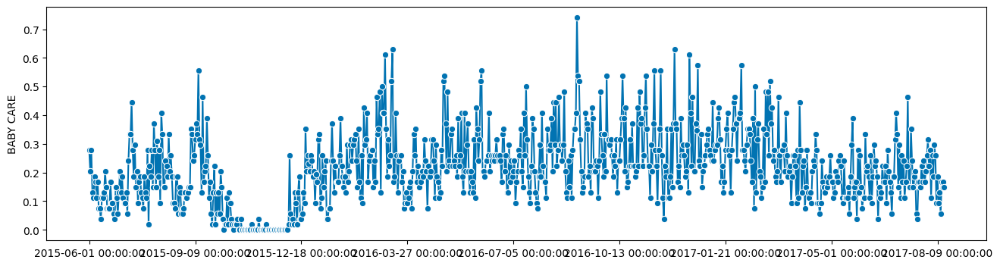

In [25]:
#change the value of BABY CARE on 2015-08-04 to remove the outlier
df_filtered.sales['BABY CARE'].loc['2015-08-04'] = 0.31

plot_series(df_filtered.sales['BABY CARE'])

##### Now I think our sales data is fairly cleaned up and ready for some further analysis. Before we get to that lets see if there are any issues with our exogenous data

In [44]:
transactions = pd.read_csv(
    'transactions.csv',
    usecols=['date', 'store_nbr', 'transactions'],
    dtype={
        'store_nbr' : 'category',
        'transactions' : 'int'
    },
    parse_dates=['date'],
    infer_datetime_format=True)

transactions = transactions.set_index(['store_nbr', 'date']).sort_index()
df_transactions = (
    transactions.groupby(['store_nbr', 'date']).sum().unstack('store_nbr')
)
df_transactions.head()

transactions                                                        \
store_nbr             1    10    11    12    13    14    15    16    17    18   
date                                                                            
2013-01-01            0     0     0     0     0     0     0     0     0     0   
2013-01-02         2111  1293  3547  1362  1102  2002  1622  1167  1580  1635   
2013-01-03         1833  1157  2675  1248   916  1823  1512  1101  1339  1484   
2013-01-04         1863   970  2515  1064   879  1641  1318   977  1139  1238   
2013-01-05         1509  1269  3052  1293  1336  2052  1543  1109  1433  1323   

                                                                              \
store_nbr     19     2 20 21 22    23    24    25    26    27    28 29     3   
date                                                                           
2013-01-01     0     0  0  0  0     0     0   770     0     0     0  0     0   
2013-01-02  1369  2358  0  0  0  1381  2605  1038  1008  1386   950  0  3487   
2013-01-03  1098  2033  0  0  0  1181  2462   887   813   928   749  0  3026   
2013-01-04  1003  2066  0  0  0  1257  2607  1054   813  1034   651  0  3188   
2013-01-05  1713  2062  0  0  0  1250  2578  1355  1081  1327  1033  0  3623   

                                                                              \
store_nbr    30    31   32    33    34   35 36    37    38    39     4    40   
date                                                                           
2013-01-01    0     0    0     0     0    0  0     0     0     0     0     0   
2013-01-02  708  1401  776  1163  2724  786  0  1691  1987  1587  1922  1178   
2013-01-03  689  1126  727  1168  2348  725  0  1526  1746  1426  1551  1171   
2013-01-04  689  1246  680   948  2369  630  0  1701  1723  1285  1596  1044   
2013-01-05  749  1317  890  1217  2599  723  0  1770  2214  1851  1825  1118   

                                                                           \
store_nbr     41 42    43    44    45    46    47    48    49     5    50   
date                                                                        
2013-01-01     0  0     0     0     0     0     0     0     0     0     0   
2013-01-02   915  0  1385  4821  4208  4886  4161  3397  2346  1903  3077   
2013-01-03   809  0  1334  3618  3314  3438  3660  2887  1702  1740  2307   
2013-01-04   835  0  1358  4169  3630  3434  3915  2900  2016  1642  2698   
2013-01-05  1021  0  1205  4921  4331  4935  4764  4084  2562  1643  3459   

                                                     
store_nbr     51 52 53   54     6     7     8     9  
date                                                 
2013-01-01     0  0  0    0     0     0     0     0  
2013-01-02  1985  0  0  998  2143  1874  3250  2940  
2013-01-03  1644  0  0  920  1795  1568  2904  2396  
2013-01-04  1786  0  0  794  1679  1513  2962  1975  
2013-01-05  2068  0  0  949  2154  1599  3060  2604

##### The main thing we need to check for here is if there any stores that did not open until a certain date in the dataset. Since we have aggregated all the store data, this could be an influence on the period of data we have selected so far.
Lets take a look at that!

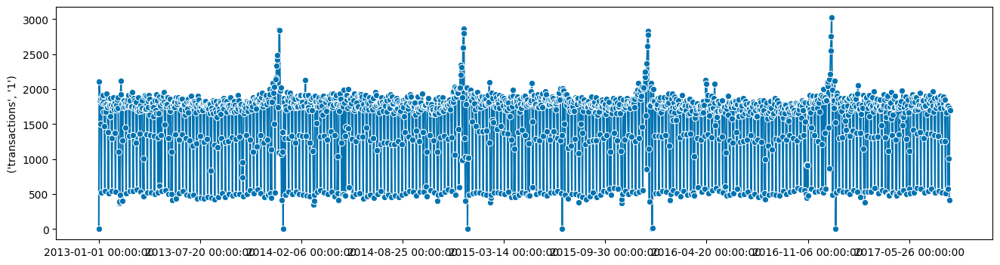

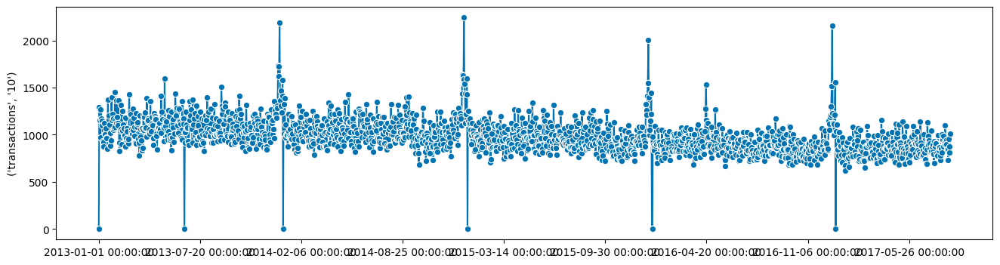

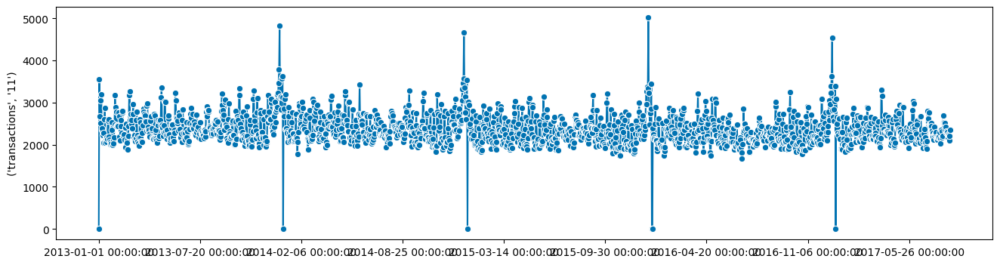

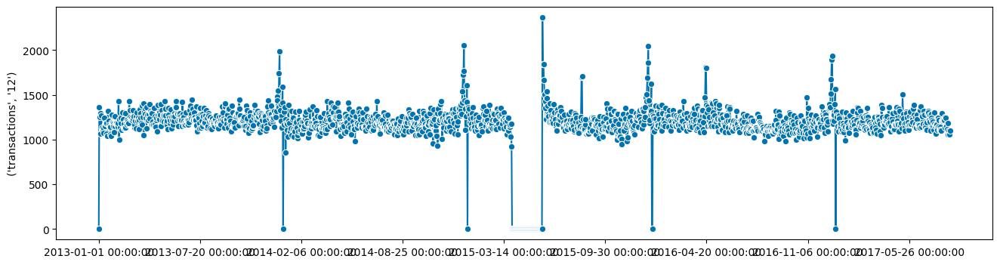

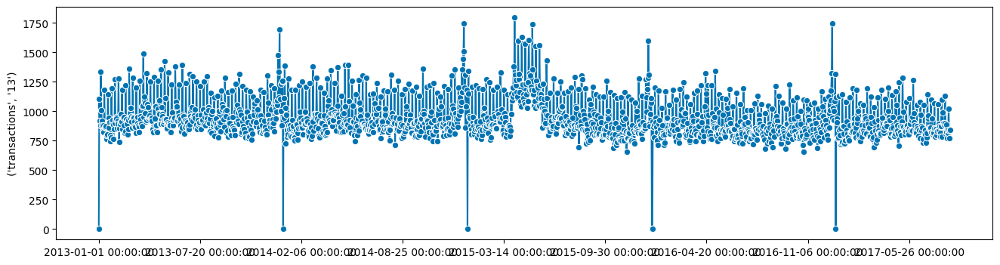

...

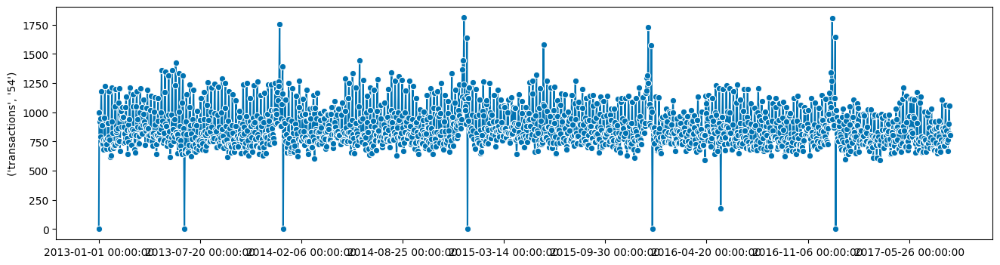

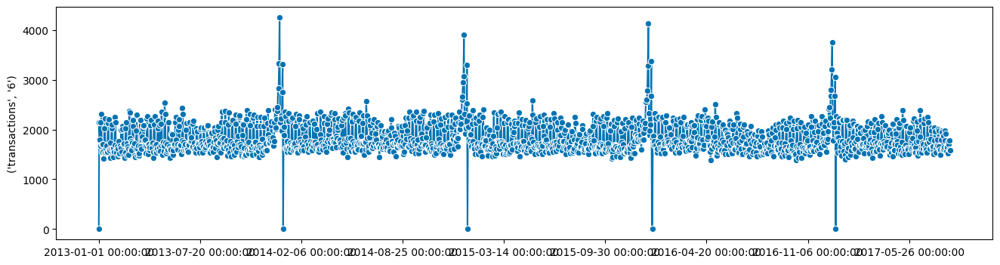

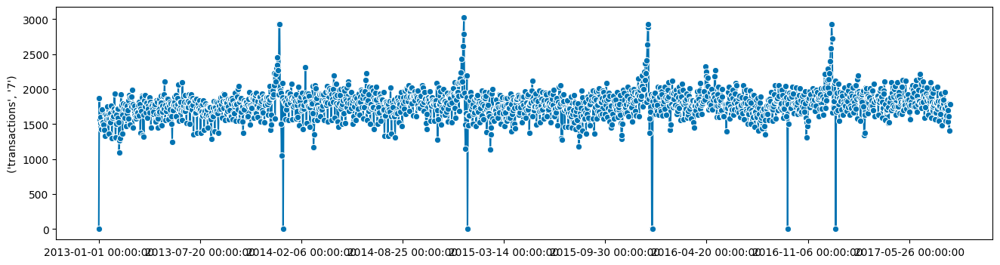

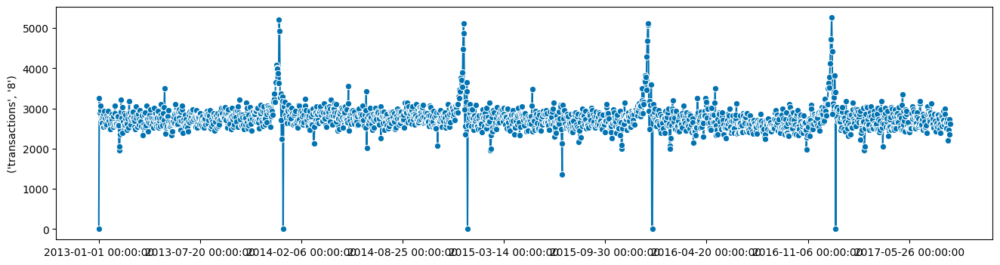

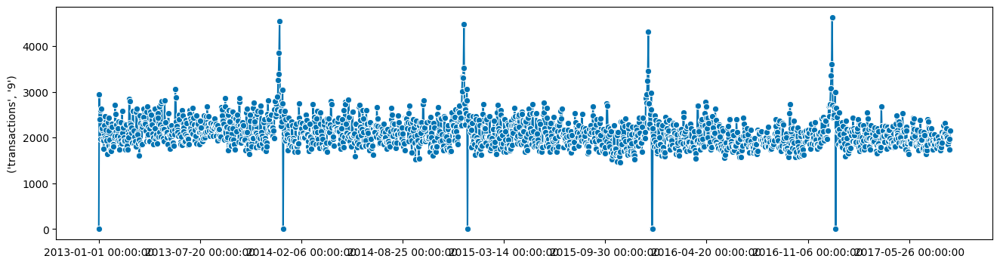

In [45]:
for col in df_transactions.columns:
    plot_series(df_transactions[col])

##### There are definitely some stores that were not open for quite a lot of the dates in the dataset. The stores in question are 20, 21, 22, 29, 42, 52, 53
Lets take a closer look at the exact dates we have selected in the training set

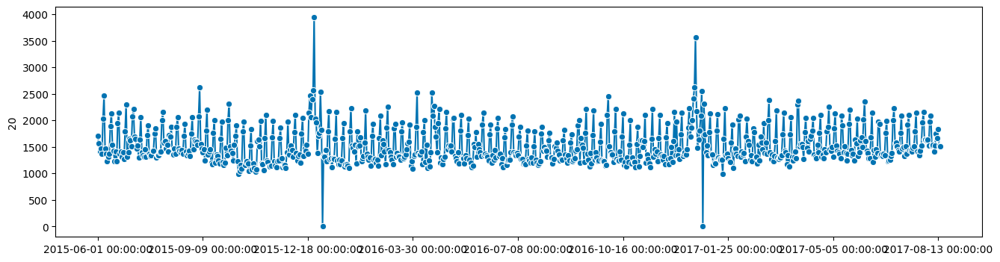

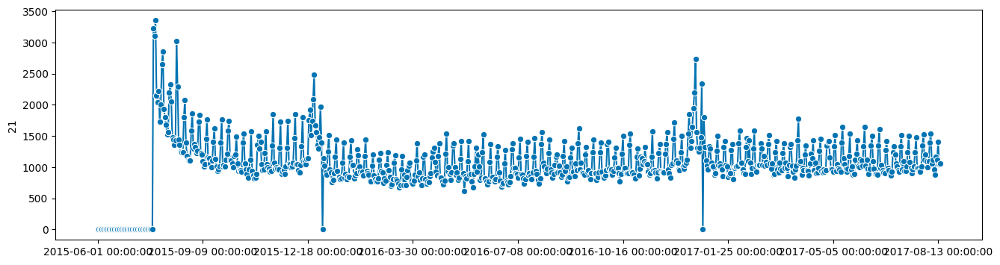

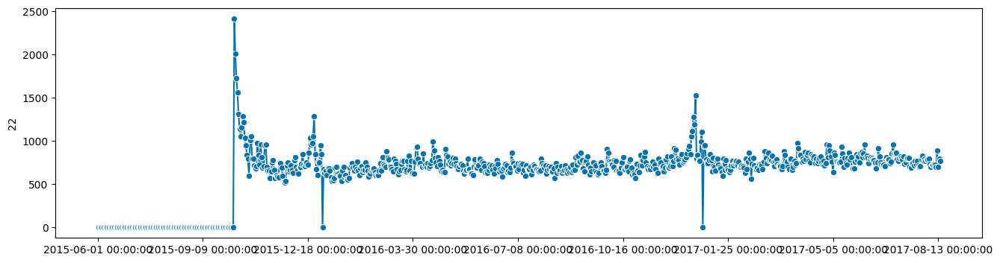

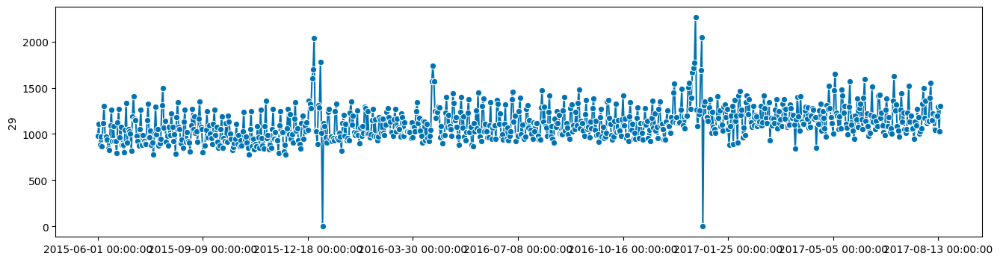

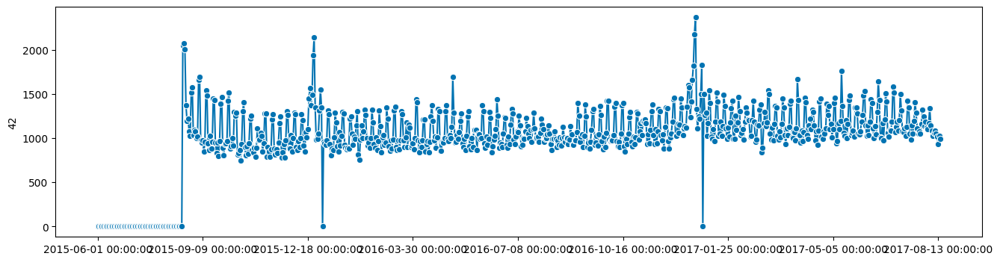

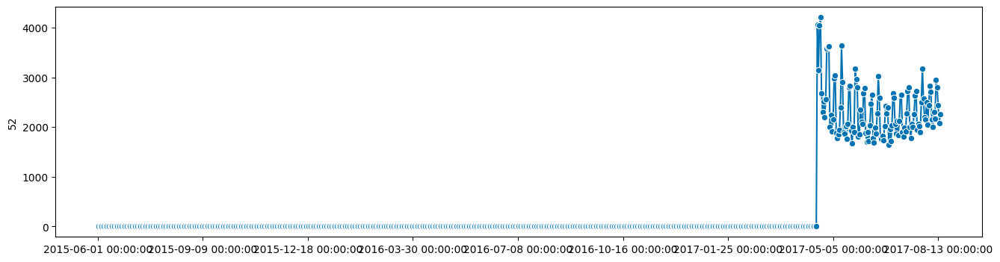

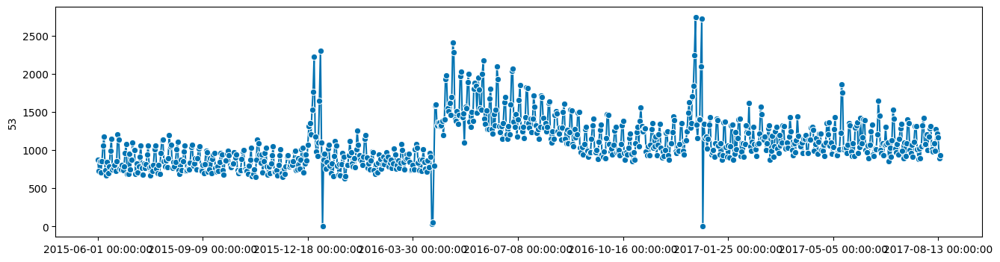

In [65]:
df_transactions_filtered = df_transactions.loc['2015-06-01' : '2017-08-15']
labels = ['20', '21', '22', '29', '42', '52', '53']
for col in labels:
    fig, ax = plot_series(df_transactions_filtered.transactions[col])

##### Looking at these during our selected time window, it seems like 21, 22 ,42 and 52 all have periods where they were not open yet. We could consider removing some of these from the training data.

Lets look at the oil price data next

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1218 entries, 2013-01-01 to 2017-08-31
Data columns (total 1 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   dcoilwtico  1175 non-null   float32
dtypes: float32(1)
memory usage: 14.3 KB


None

(482,)

(<Figure size 1600x400 with 1 Axes>, <AxesSubplot: >)

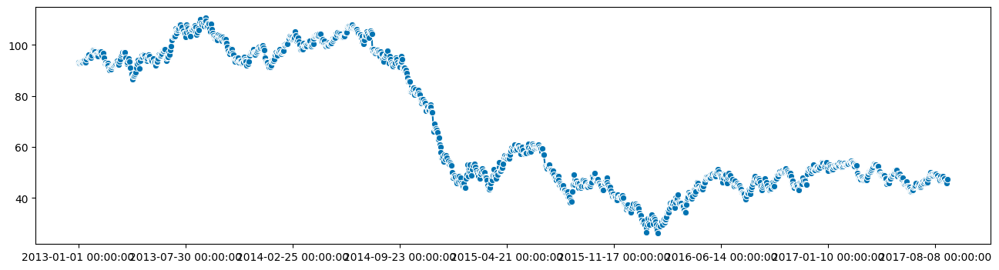

In [81]:
df_oil = pd.read_csv(
    'oil.csv',
    usecols=['date', 'dcoilwtico'],
    dtype={
        'dcoilwtico' : 'float32'
    },
    parse_dates=['date'],
    infer_datetime_format=True)

df_oil = df_oil.set_index(['date']).sort_index()
display(df_oil.info())

missing = pd.date_range(start = '2013-01-01', end='2017-08-15').difference(df_oil.index)
display(missing.shape)
plot_series(df_oil)

##### There are a lot of missing dates with these oil prices. Because this data is extremely stable within short time windows and we have so much of the data, we should be able to do a simple interpolation to fix that.

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1704 entries, 2013-01-01 to 2017-08-31
Data columns (total 1 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   dcoilwtico  1703 non-null   float32
dtypes: float32(1)
memory usage: 20.0 KB


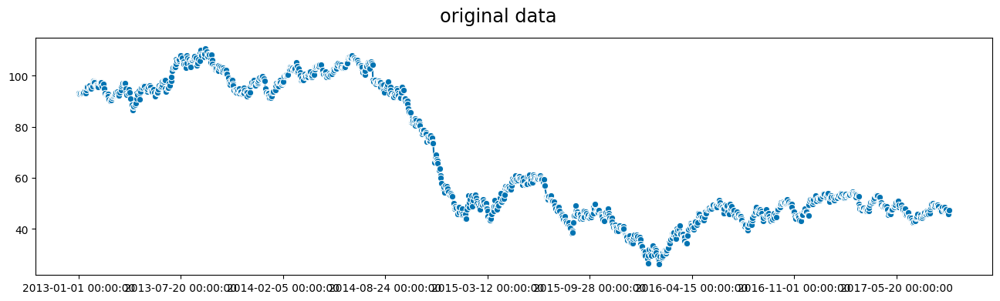

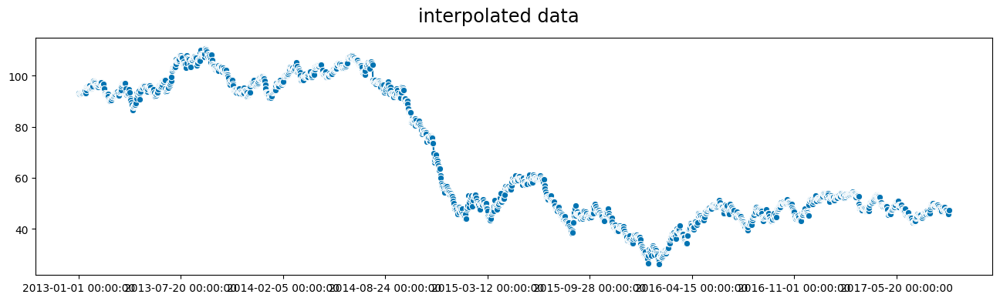

In [129]:
#add rows for missing dates
df_oil = df_oil.dcoilwtico.resample('D').sum().reset_index()

#interpolate the missing prices
df_oil.rename(columns={0 : 'dcoilwtico'}, inplace=True)
df_oil['dcoilwtico'] = np.where(df_oil['dcoilwtico'] == 0, np.nan, df_oil['dcoilwtico'])
df_oil_interp = df_oil.dcoilwtico.interpolate()
df_oil.set_index('index', inplace=True)
df_oil_interp = pd.DataFrame(index=df_oil.index, data=df_oil_interp.values, columns=['dcoilwtico'])

fig, ax = plot_series(df_oil, title='original data')
fig, ax = plot_series(df_oil_interp, title='interpolated data')
df_oil_interp.info()

##### Now that we have that problem taken care of. That leaves two more files included with the dataset: stores.csv and holidays_events.csv. Since we are aggregating all of the stores into a company wide sales figure, the store metadata will not be useful, although we could definitely try to use it if we were predicting at the store level.
Lets take a look at the holidays data

In [135]:
holidays = pd.read_csv(
    'holidays_events.csv',
    usecols=['date', 'type', 'locale', 'transferred'],
    dtype={
        'type' : 'category',
        'locale' : 'category',
        'transferred' : 'bool'
    },
    parse_dates=['date'],
    infer_datetime_format=True)

holidays = holidays.set_index(['date']).sort_index()
display(holidays.info())
display(holidays.value_counts())
df_holidays = holidays.loc['2015-06-01' : '2017-08-15']
df_holidays.shape

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 350 entries, 2012-03-02 to 2017-12-26
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   type         350 non-null    category
 1   locale       350 non-null    category
 2   transferred  350 non-null    bool    
dtypes: bool(1), category(2)
memory usage: 4.1 KB


None

type        locale    transferred
Holiday     Local     False          133
Event       National  False           56
Holiday     National  False           52
Additional  National  False           40
Holiday     Regional  False           24
Additional  Local     False           11
Holiday     National  True             8
Transfer    National  False            8
Bridge      National  False            5
Work Day    National  False            5
Holiday     Local     True             4
Transfer    Local     False            4
dtype: int64

(152, 3)

##### That looks clean enough to be used with some processing. 
Now that we have check and done some basic cleaning of the dataset, we can move on to some exploratory analysis to inform the building of our prediction model

##### Lets start by taking a look at some descriptive statistics to tell us more about the time series

A time series is said to be **stationary** if its mean, variance and covariance **do not** vary with time. This property is a requirement for some forms of statistical modeling. One way to determing this is through the use of two different statistical tests. The Augmented Dickey-Fuller test, and the MPSS test.


In [223]:
#lets write a function to perform and display an Augmented Dickey Fuller test
#And a KPSS test to check for stationarity
from statsmodels.tsa.stattools import adfuller, kpss
def adf_kpss_test(ts):
    print('Augmented Dickey-Fuller: ')
    adftest = pd.Series(
            adfuller(ts)[0:4],
            index=['Test Statistic', 'p-value', 'Num Lags', 'Num Obs']
    )
    print(adftest)
    for key, value in adfuller(ts)[4].items():
        print('Critical Value {}  : {}'.format(key, value))
    
    print("\nKPSS: ")
    kpsstest = pd.Series(
            kpss(ts)[0:3], index=['Test Statistic', 'p-value', 'Num Lags']
    )
    print(kpsstest)
    for key, value in kpss(ts)[3].items():
        print('Critical Value {}  : {}'.format(key,value))

for col in df_analysis.sales.columns:
        print('TESTING {}'.format(col))
        adf_kpss_test(df_analysis.sales[col])
        print('\n')



TESTING AUTOMOTIVE
Augmented Dickey-Fuller: 
Test Statistic    -4.20
p-value            0.00
Num Lags          21.00
Num Obs          785.00
dtype: float64
Critical Value 1%  : -3.438707722728768
Critical Value 5%  : -2.8652288644673125
Critical Value 10%  : -2.568734303622865

KPSS: 
Test Statistic    0.47
p-value           0.05
Num Lags         12.00
dtype: float64
Critical Value 10%  : 0.347
Critical Value 5%  : 0.463
Critical Value 2.5%  : 0.574
Critical Value 1%  : 0.739


TESTING BABY CARE
Augmented Dickey-Fuller: 
Test Statistic    -3.03
p-value            0.03
Num Lags          13.00
Num Obs          793.00
dtype: float64
Critical Value 1%  : -3.438623132449471
Critical Value 5%  : -2.8651915799370014
Critical Value 10%  : -2.568714441670417

KPSS: 
Test Statistic    1.26
p-value           0.01
Num Lags         15.00
dtype: float64
Critical Value 10%  : 0.347
Critical Value 5%  : 0.463
Critical Value 2.5%  : 0.574
Critical Value 1%  : 0.739


TESTING BEAUTY
Augmented Dickey-Ful

##### Interpreting the results of stationarity tests :
For the **Augmented Dickey-Fuller**, the test is as follows:  
**H0 :** The series has a unit root (Non-Stationary)  
**HA :** The series has no unit root (Stationary)

For **MPSS**, the test is as follows:  
**H0 :** The process is trend stationary (Stationary)  
**HA :** The series has a unit root (Non-Stationary)  

For non-stationary data, combining the results of both tests can potentially tell us more about how we could make the series stationary.  

**Strict Stationary:** both tests claim series is stationary  
**Non Stationary:** both tests claim series is not stationary  
**Trend Stationary:** KPSS claims stationary, ADF claims non-stationary  
**Difference Stationary:** ADF claims stationary, KPSS claims non-stationary

To make a trend stationary series strict stationary, one must remove the trend  
To make a difference stationary series strict stationary, one must apply differencing  


### Results for our sales data (using 95% confidence interval):
**AUTOMOTIVE     :** Difference Stationary  
**BABY CARE      :** Difference Stationary  
**BEAUTY         :** Difference Stationary  
**BEVERAGES      :** Difference Stationary  
**BOOKS          :** Non Stationary  
**BREAD/BAKERY   :** Difference Stationary  
**CELEBRATION    :** Stationary  
**CLEANING       :** Difference Stationary  
**DAIRY          :** Difference Stationary  
**DELI           :** Difference Stationary  
**EGGS           :** Non Stationary  
**FROZEN FOODS   :** Trend Stationary  
**GROCERY I      :** Difference Stationary  
**GROCERY II     :** Difference Stationary  
**HARDWARE       :** Difference Stationary  
**HOME KITCHEN I :** Stationary  
**HOME KITCHEN II:** Stationary  
**HOME APPLIANCES:** Non Stationary  
**HOME CARE      :** Difference Stationary  
**LADIESWEAR     :** Stationary  
**LAWN AND GARDEN:** Non Stationary  
**LINGERIE       :** Difference Stationary  
**LIQUOR,WINEBEER:** Stationary  
**MAGAZINES      :** Difference Stationary  
**MEATS          :** Difference Stationary  
**PERSONAL CARE  :** Difference Stationary  
**PET SUPPLIES   :** Non Stationary  
**PLAYERS ELECTRO:** Difference Stationary  
**POULTRY        :** Stationary  
**PREPARED FOODS :** Non Stationary  
**PRODUCE        :** Difference Stationary  
**SCHOOL AND OFFI:** Stationary  
**SEAFOOD        :** Difference Stationary  


We can see that most of our data is not stationary, although it could be made stationary by applying some form of differencing. It is also important to note that these tests will not capture every form of stationarity, and visual inspection should be used as well to sanity test.